**Navigation:**
- [Part 1: Data Exploration](#part-1-data-exploration)
- [Part 2: Feature engineering](#part-2-feature-engineering)
- [Part 3: Spectral Clustering Implementation](#part-3-spectral-clustering-implementation)
- [Part 4: Params Tuning](#part-4-params-tuning)

In [1]:
# Import libraries
import pandas as pd

# Visualization imports
import plotly.express as px
import plotly.graph_objects as go
import numpy as np

### Variable Information

This dataset contains geospatial and timestamp data for one week worth of Tweets in the contiguous United States. The Tweets were created between January 12, 2013 and January 18, 2013. The exact location (i.e., longitude and latitude) and timestamp (hour, minute, second) of each Tweet was recorded. All timestamps are reported in central standard time in the format "YYYY-MM-DD HH:MM:SS". The geo-tag information was used to assign each Tweet to one of the four standard time zones.

Class Labels

1. longitude: exact longitude coordinate of Tweet (real valued)
2. latitude: exact latitude coordinate of Tweet (real valued)
3. timestamp: 20130112000000 = 2013-01-12 00:00:00 CST (integer)

In [2]:
# Read dataset
twitter = pd.read_csv('data/twitter.csv')
print(twitter.head())

   longitude   latitude       timestamp  timezone
0 -87.895450  43.063007  20130112000000         2
1 -93.674799  45.025114  20130112000000         2
2 -97.104568  32.709685  20130112000000         2
3 -71.120095  42.351453  20130112000000         1
4 -79.048690  43.100826  20130112000000         1


## Part 1: Data Exploration

Load and examine the Twitter dataset

In [7]:

# Display basic information about the dataset
print("Dataset Shape:", twitter.shape)
print("\nDataset Info:")
twitter.info()

Dataset Shape: (14262517, 5)

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14262517 entries, 0 to 14262516
Data columns (total 5 columns):
 #   Column     Dtype         
---  ------     -----         
 0   longitude  float64       
 1   latitude   float64       
 2   timestamp  int64         
 3   timezone   int64         
 4   datetime   datetime64[ns]
dtypes: datetime64[ns](1), float64(2), int64(2)
memory usage: 544.1 MB


In [6]:

# Check for null values
print("\nNull Values:")
print(twitter.isnull().sum())


Null Values:
longitude    0
latitude     0
timestamp    0
timezone     0
datetime     0
dtype: int64


In [5]:

# Convert timestamp to datetime
twitter['datetime'] = pd.to_datetime(twitter['timestamp'].astype(str), format='%Y%m%d%H%M%S')

In [8]:

# Analyze temporal distribution
twitter['hour'] = twitter['datetime'].dt.hour
twitter['date'] = twitter['datetime'].dt.date

# Plot tweets by hour
fig = px.histogram(twitter, 
                  x='hour',
                  color='timezone',
                  title='Tweet Distribution by Hour and Timezone',
                  labels={'hour': 'Hour of Day', 'count': 'Number of Tweets'})
fig.show()

In [12]:
# Ground truth timezone distribution
print(f"\n📊 Timezone Distribution:")
print(f"   Total tweets: {len(twitter)}")
print(f"   Unique timezones: {twitter['timezone'].nunique()}")
print(f"\nTop 10 timezones:")
timezone_counts = twitter['timezone'].value_counts()
for i, (tz, count) in enumerate(timezone_counts.head(10).items(), 1):
    pct = (count / len(twitter)) * 100
    print(f"   {i}. {tz}: {count} ({pct:.1f}%)")
    
# Plot tweets by date
daily_counts = twitter.groupby(['date', 'timezone']).size().reset_index(name='counts')
fig = px.line(daily_counts, 
              x='date', 
              y='counts',
              color='timezone',
              title='Tweet Volume by Date and Timezone')
fig.show()


📊 Timezone Distribution:
   Total tweets: 14262517
   Unique timezones: 4

Top 10 timezones:
   1. 1: 7404613 (51.9%)
   2. 2: 4382578 (30.7%)
   3. 4: 2094968 (14.7%)
   4. 3: 380358 (2.7%)


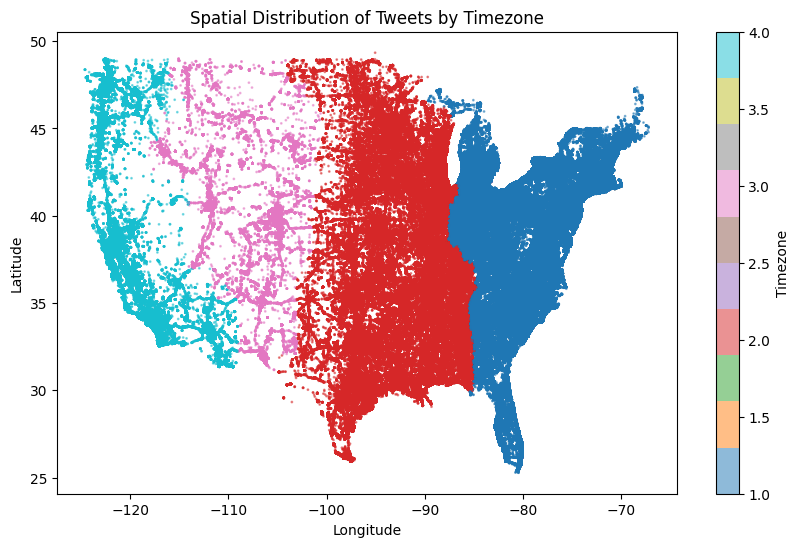

In [14]:
# Visualize spatial distribution using a simple scatter plot
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
scatter = plt.scatter(
    twitter['longitude'], twitter['latitude'],
    c=twitter['timezone'], cmap='tab10', s=1, alpha=0.5
)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Spatial Distribution of Tweets by Timezone')
plt.colorbar(scatter, label='Timezone')
plt.show()

# Part 2: Feature engineering
### Prepare the features for spectral clustering by:
- Normalizing longitude and latitude
- Converting hour to circular features to handle time periodicity

In [13]:
# Prepare features for spectral clustering
X = twitter[['longitude', 'latitude']].copy()
# Normalize features
X = (X - X.mean()) / X.std()

# Add hour of day as circular feature
hour_rad = twitter['hour'] * (2 * np.pi / 24)
X['hour_x'] = np.cos(hour_rad)
X['hour_y'] = np.sin(hour_rad)

print("\nPrepared features shape:", X.shape)


Prepared features shape: (14262517, 4)


In [28]:
# Sample X since it's large
X_sampled = X.sample(10000, random_state=42)

In [29]:
# Check feature distributions
fig = px.box(X_sampled, title='Feature Distributions after Normalization')
fig.show()

In [30]:
# Compute feature correlations
correlation_matrix = X_sampled.corr()
fig = px.imshow(correlation_matrix,
                title='Feature Correlations',
                color_continuous_scale='RdBu')
fig.show()

# Part 3: Spectral Clustering Implementation
## Spectral Clustering Methodology

Spectral clustering is an advanced clustering technique that leverages principles from graph theory and linear algebra to perform dimensionality reduction before clustering. Here's how it works:

### 1. Similarity Graph Construction
- Construct a similarity matrix S between all data points using a kernel function
- Common choice: Gaussian (RBF) kernel
  ```
  S_{ij} = exp(-||x_i - x_j||^2 / (2σ^2))
  ```
- Result: Graph where nodes are data points, edges represent similarities

### 2. Graph Laplacian Formation
- Degree matrix D: diagonal matrix where D_{ii} = Σ_j S_{ij}
- Compute Laplacian matrix: L = D - S
- Three common variants:
  - Unnormalized: L = D - S
  - Symmetric: L_sym = I - D^(-1/2)SD^(-1/2)
  - Random walk: L_rw = I - D^(-1)S

### 3. Eigendecomposition
- Find k smallest eigenvalues/eigenvectors of Laplacian
- k is usually number of desired clusters
- Eigengap heuristic can help determine optimal k
- Creates lower-dimensional representation preserving cluster structure

### 4. Final Clustering
- Use first k eigenvectors as new data representation
- Apply k-means in this spectral embedding space
- Results often superior to direct k-means on original data

### Why It's Suitable for Timezone Classification
1. **Non-linear Boundaries**: Can handle complex timezone boundaries
2. **Multi-modal Data**: Effectively combines spatial (lat/long) and temporal (hour) features
3. **Robust to Noise**: Less sensitive to outliers than traditional clustering
4. **Connected Components**: Natural for geographic clustering problems

In [31]:
from sklearn.preprocessing import StandardScaler
from scipy.sparse.linalg import eigsh
from scipy.sparse import csr_matrix
from sklearn.cluster import KMeans
import numpy as np

def rbf_kernel_matrix(X_sampled, gamma=1.0):
    """Compute RBF kernel matrix using efficient broadcasting"""
    # Compute squared Euclidean distances
    sq_dists = np.sum(X_sampled**2, axis=1)[:, np.newaxis] + np.sum(X_sampled**2, axis=1) - 2 * X_sampled @ X_sampled.T
    return np.exp(-gamma * sq_dists)

In [32]:
def spectral_clustering(X, n_clusters=4, gamma=1.0):
    """
    Perform spectral clustering
    
    Parameters:
    - X: feature matrix
    - n_clusters: number of clusters (default=4 for timezones)
    - gamma: RBF kernel parameter
    
    Returns:
    - labels: cluster assignments
    """
    print("Computing similarity matrix...")
    # Compute similarity matrix using RBF kernel
    similarity_matrix = rbf_kernel_matrix(X, gamma)
    
    print("Computing graph Laplacian...")
    # Compute degree matrix
    degrees = np.sum(similarity_matrix, axis=1)
    D = np.diag(degrees)
    
    # Compute normalized Laplacian (symmetric)
    D_sqrt_inv = np.diag(1.0 / np.sqrt(degrees))
    L = np.eye(len(X)) - D_sqrt_inv @ similarity_matrix @ D_sqrt_inv
    
    print("Computing eigendecomposition...")
    # Get the k smallest eigenvalues and eigenvectors
    eigenvalues, eigenvectors = eigsh(L, k=n_clusters, which='SM')
    
    print("Applying k-means to eigenvectors...")
    # Apply k-means to the eigenvectors
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    labels = kmeans.fit_predict(eigenvectors)
    
    return labels, eigenvalues, eigenvectors

In [35]:
# Apply spectral clustering to sampled data
print("Starting spectral clustering...")
n_clusters = twitter['timezone'].nunique()  # Use number of unique timezones
labels, eigenvalues, eigenvectors = spectral_clustering(X_sampled.values, n_clusters=n_clusters)

# Evaluate clustering results
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# Get ground truth labels for sampled data
true_labels = twitter.loc[X_sampled.index, 'timezone']

# Calculate metrics
ari = adjusted_rand_score(true_labels, labels)
nmi = normalized_mutual_info_score(true_labels, labels)

print(f"\nClustering Results:")
print(f"Number of clusters: {n_clusters}")
print(f"Adjusted Rand Index: {ari:.3f}")
print(f"Normalized Mutual Information: {nmi:.3f}")

Starting spectral clustering...
Computing similarity matrix...
Computing graph Laplacian...
Computing graph Laplacian...
Computing eigendecomposition...
Computing eigendecomposition...
Applying k-means to eigenvectors...

Clustering Results:
Number of clusters: 4
Adjusted Rand Index: 0.343
Normalized Mutual Information: 0.439
Applying k-means to eigenvectors...

Clustering Results:
Number of clusters: 4
Adjusted Rand Index: 0.343
Normalized Mutual Information: 0.439


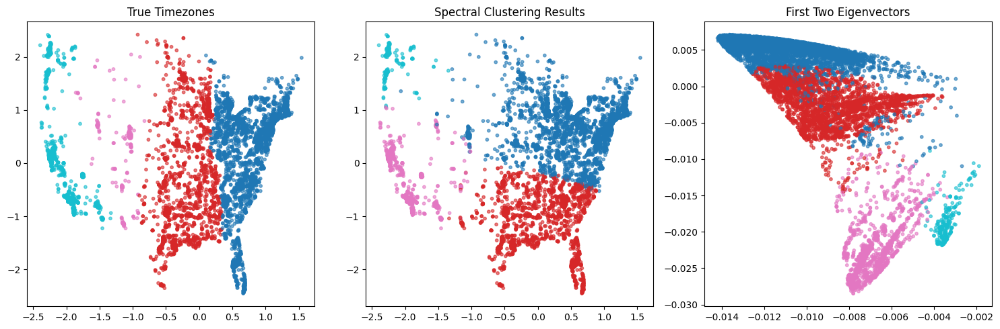

In [36]:
# Visualization of clustering results
fig = plt.figure(figsize=(15, 5))

# Plot 1: Original data with true timezone labels
plt.subplot(131)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=true_labels.astype('category').cat.codes, 
            cmap='tab10', alpha=0.6, s=10)
plt.title('True Timezones')

# Plot 2: Spectral clustering results
plt.subplot(132)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=labels, cmap='tab10', alpha=0.6, s=10)
plt.title('Spectral Clustering Results')

# Plot 3: First two eigenvectors
plt.subplot(133)
plt.scatter(eigenvectors[:, 0], eigenvectors[:, 1], 
            c=labels, cmap='tab10', alpha=0.6, s=10)
plt.title('First Two Eigenvectors')

plt.tight_layout()
plt.show()

### Use in-built Scikit learn spectral clustering

Performing spectral clustering...

Clustering Results:
Number of clusters: 4
Adjusted Rand Index: 0.362
Normalized Mutual Information: 0.448

Clustering Results:
Number of clusters: 4
Adjusted Rand Index: 0.362
Normalized Mutual Information: 0.448


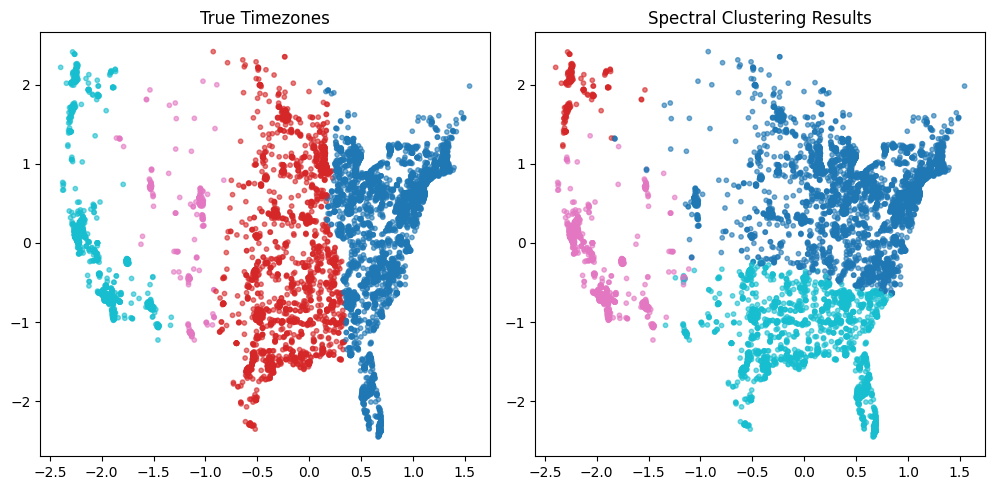

In [38]:
from sklearn.cluster import SpectralClustering
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score

# Initialize SpectralClustering
n_clusters = twitter['timezone'].nunique()
spectral = SpectralClustering(
    n_clusters=n_clusters,
    affinity='rbf',  # RBF kernel
    gamma=1.0,       # RBF kernel coefficient
    random_state=42,
    n_jobs=-1        # Use all CPU cores
)

# Fit and predict
print("Performing spectral clustering...")
labels = spectral.fit_predict(X_sampled)

# Get ground truth labels for sampled data
true_labels = twitter.loc[X_sampled.index, 'timezone']

# Calculate metrics
ari = adjusted_rand_score(true_labels, labels)
nmi = normalized_mutual_info_score(true_labels, labels)

print(f"\nClustering Results:")
print(f"Number of clusters: {n_clusters}")
print(f"Adjusted Rand Index: {ari:.3f}")
print(f"Normalized Mutual Information: {nmi:.3f}")

# Visualization of clustering results
fig = plt.figure(figsize=(15, 5))

# Plot 1: Original data with true timezone labels
plt.subplot(131)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=true_labels.astype('category').cat.codes, 
            cmap='tab10', alpha=0.6, s=10)
plt.title('True Timezones')

# Plot 2: Spectral clustering results
plt.subplot(132)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=labels, cmap='tab10', alpha=0.6, s=10)
plt.title('Spectral Clustering Results')

plt.tight_layout()
plt.show()

# Part 4: Params Tuning

Tests different combinations of important parameters:

- gamma: Controls the width of the RBF kernel (affects similarity computation)
- n_neighbors: Number of neighbors for constructing the affinity matrix
- assign_labels: Method for final label assignment

Key parameter effects:
- Higher gamma values make the clustering more sensitive to local structure
- Lower gamma values consider more global structure
- n_neighbors affects how connected the similarity graph is
- 'discretize' assignment might work better than 'kmeans' for geographic boundaries

The best parameters will be selected based on ARI score (comparing to ground truth timezones)

Parameter Tuning Results:
--------------------------------------------------------------------------------
gamma=0.1, n_neighbors=10, assign_labels=kmeans
ARI: 0.241, NMI: 0.384
----------------------------------------
gamma=0.1, n_neighbors=10, assign_labels=kmeans
ARI: 0.241, NMI: 0.384
----------------------------------------
gamma=0.1, n_neighbors=10, assign_labels=discretize
ARI: 0.239, NMI: 0.380
----------------------------------------
gamma=0.1, n_neighbors=10, assign_labels=discretize
ARI: 0.239, NMI: 0.380
----------------------------------------
gamma=0.1, n_neighbors=30, assign_labels=kmeans
ARI: 0.241, NMI: 0.384
----------------------------------------
gamma=0.1, n_neighbors=30, assign_labels=kmeans
ARI: 0.241, NMI: 0.384
----------------------------------------
gamma=0.1, n_neighbors=30, assign_labels=discretize
ARI: 0.239, NMI: 0.380
----------------------------------------
gamma=0.1, n_neighbors=30, assign_labels=discretize
ARI: 0.239, NMI: 0.380
----------------------

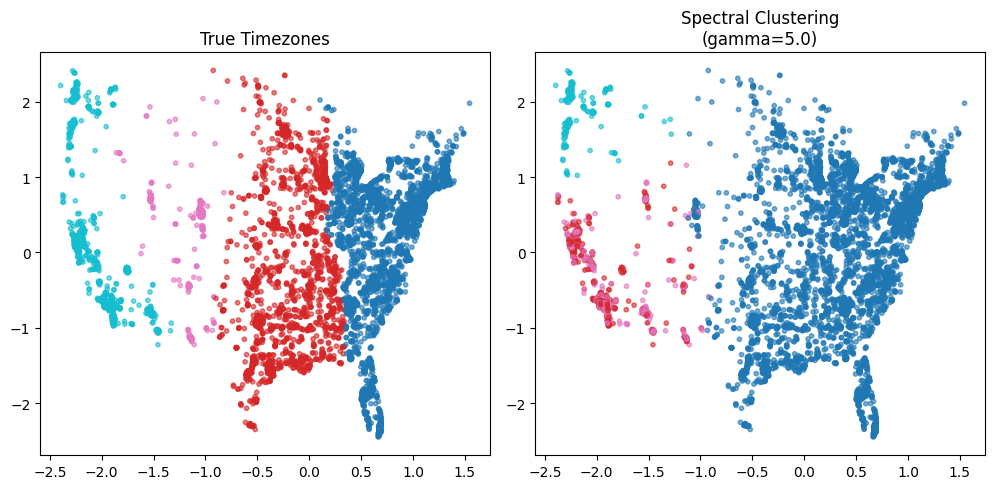

In [39]:
# Parameter tuning for SpectralClustering
from itertools import product

# Define parameter ranges
gamma_range = [0.1, 0.5, 1.0, 2.0, 5.0]
n_neighbors_range = [10, 30, 50]
assign_labels = ['kmeans', 'discretize']

# Store results
tuning_results = []

print("Parameter Tuning Results:")
print("-" * 80)

for gamma, n_neighbors, assign_method in product(gamma_range, n_neighbors_range, assign_labels):
    # Initialize SpectralClustering with current parameters
    spectral = SpectralClustering(
        n_clusters=n_clusters,
        affinity='rbf',
        gamma=gamma,
        n_neighbors=n_neighbors,
        assign_labels=assign_method,
        random_state=42,
        n_jobs=-1
    )
    
    # Fit and predict
    labels = spectral.fit_predict(X_sampled)
    
    # Calculate metrics
    ari = adjusted_rand_score(true_labels, labels)
    nmi = normalized_mutual_info_score(true_labels, labels)
    
    # Store results
    tuning_results.append({
        'gamma': gamma,
        'n_neighbors': n_neighbors,
        'assign_labels': assign_method,
        'ARI': ari,
        'NMI': nmi
    })
    
    print(f"gamma={gamma:.1f}, n_neighbors={n_neighbors}, assign_labels={assign_method}")
    print(f"ARI: {ari:.3f}, NMI: {nmi:.3f}")
    print("-" * 40)

# Find best parameters
best_result = max(tuning_results, key=lambda x: x['ARI'])
print("\nBest Parameters:")
print(f"gamma: {best_result['gamma']}")
print(f"n_neighbors: {best_result['n_neighbors']}")
print(f"assign_labels: {best_result['assign_labels']}")
print(f"Best ARI: {best_result['ARI']:.3f}")
print(f"Best NMI: {best_result['NMI']:.3f}")

# Apply best parameters
best_spectral = SpectralClustering(
    n_clusters=n_clusters,
    affinity='rbf',
    gamma=best_result['gamma'],
    n_neighbors=best_result['n_neighbors'],
    assign_labels=best_result['assign_labels'],
    random_state=42,
    n_jobs=-1
)

# Fit and predict with best parameters
best_labels = best_spectral.fit_predict(X_sampled)

# Visualize results with best parameters
fig = plt.figure(figsize=(15, 5))

# Plot 1: Original data with true timezone labels
plt.subplot(131)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=true_labels.astype('category').cat.codes, 
            cmap='tab10', alpha=0.6, s=10)
plt.title('True Timezones')

# Plot 2: Best spectral clustering results
plt.subplot(132)
plt.scatter(X_sampled['longitude'], X_sampled['latitude'], 
            c=best_labels, cmap='tab10', alpha=0.6, s=10)
plt.title(f'Spectral Clustering\n(gamma={best_result["gamma"]:.1f})')

plt.tight_layout()
plt.show()